In [114]:
import numpy as np # linear algebra
import pandas as pd #import pandas 
from sklearn.cluster import KMeans 
# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from datetime import date
import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

## **Customer Purchase Behavior Analysis** ##

#### Import dataset & data exploratary ####

In [115]:
data_description = pd.read_csv('./Marketing+Data/marketing_data_dictionary.csv')
main_df = pd.read_csv('./Marketing+Data/marketing_data.csv')

In [116]:
main_df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country
0,1826,1970,Graduation,Divorced,84835.0,0,0,2014-06-16,0,189,104,379,111,189,218,1,4,4,6,1,0,0,0,0,0,1,0,Spain
1,1,1961,Graduation,Single,57091.0,0,0,2014-06-15,0,464,5,64,7,0,37,1,7,3,7,5,0,0,0,0,1,1,0,Canada
2,10476,1958,Graduation,Married,67267.0,0,1,2014-05-13,0,134,11,59,15,2,30,1,3,2,5,2,0,0,0,0,0,0,0,USA
3,1386,1967,Graduation,Together,32474.0,1,1,2014-05-11,0,10,0,1,0,0,0,1,1,0,2,7,0,0,0,0,0,0,0,Australia
4,5371,1989,Graduation,Single,21474.0,1,0,2014-04-08,0,6,16,24,11,0,34,2,3,1,2,7,1,0,0,0,0,1,0,Spain


In [117]:
#creat a copy of the original dataset
df = main_df.copy()

In [118]:
#check the shape of the datase 
print("Shape of the DataFrame is :",df.shape)

Shape of the DataFrame is : (2240, 28)


In [119]:
#Check the column in the dataset 
print("Columns in the DataFrame are : \n", df.columns)

Columns in the DataFrame are : 
 Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', ' Income ',
       'Kidhome', 'Teenhome', 'Dt_Customer', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Response', 'Complain', 'Country'],
      dtype='object')


In [120]:
#remove the whitesapce in column name 
df.rename(columns=lambda x: x.strip(), inplace=True)
print(df.columns)

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Response', 'Complain', 'Country'],
      dtype='object')


In [121]:
#check the data info in the dataset 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

#### Data Cleanning ####

In [122]:
#find all the missing value in this dataset
total_missing = df.isnull().sum().sort_values(ascending = False)
total_missing

Income                 24
ID                      0
NumDealsPurchases       0
Complain                0
Response                0
AcceptedCmp2            0
AcceptedCmp1            0
AcceptedCmp5            0
AcceptedCmp4            0
AcceptedCmp3            0
NumWebVisitsMonth       0
NumStorePurchases       0
NumCatalogPurchases     0
NumWebPurchases         0
MntGoldProds            0
Year_Birth              0
MntSweetProducts        0
MntFishProducts         0
MntMeatProducts         0
MntFruits               0
MntWines                0
Recency                 0
Dt_Customer             0
Teenhome                0
Kidhome                 0
Marital_Status          0
Education               0
Country                 0
dtype: int64

In [123]:
#fill the missing income value with median income 
df['Income'] = df['Income'].fillna(df['Income'].median())

In [124]:
#check if there is any null value in the dataframe after fill the missing income with median income
df.isna().any()

ID                     False
Year_Birth             False
Education              False
Marital_Status         False
Income                 False
Kidhome                False
Teenhome               False
Dt_Customer            False
Recency                False
MntWines               False
MntFruits              False
MntMeatProducts        False
MntFishProducts        False
MntSweetProducts       False
MntGoldProds           False
NumDealsPurchases      False
NumWebPurchases        False
NumCatalogPurchases    False
NumStorePurchases      False
NumWebVisitsMonth      False
AcceptedCmp3           False
AcceptedCmp4           False
AcceptedCmp5           False
AcceptedCmp1           False
AcceptedCmp2           False
Response               False
Complain               False
Country                False
dtype: bool

In [125]:
#check duplicates value
df[df.duplicated()]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country


In [126]:
#check if there are any data with persistence value that we do not need in our dataframe
df.nunique()

ID                     2240
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1975
Kidhome                   3
Teenhome                  3
Dt_Customer             663
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         558
MntFishProducts         182
MntSweetProducts        177
MntGoldProds            213
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Response                  2
Complain                  2
Country                   8
dtype: int64

In [127]:
#find the value of the second highest income to remove the outlier in the data set 
df[df['Income']>69000].sort_values(by='Income',ascending=False)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country
527,9432,1977,Graduation,Together,666666.0,1,0,2013-06-02,23,9,14,18,8,1,12,4,3,1,3,6,0,0,0,0,0,0,0,Saudi Arabia
731,1503,1976,PhD,Together,162397.0,1,1,2013-06-03,31,85,1,16,2,1,2,0,0,0,1,1,0,0,0,0,0,0,0,Spain
497,1501,1982,PhD,Married,160803.0,0,0,2012-08-04,21,55,16,1622,17,3,4,15,0,28,1,0,0,0,0,0,0,0,0,USA
853,5336,1971,Master,Together,157733.0,1,0,2013-06-04,37,39,1,9,2,0,8,0,1,0,1,1,0,0,0,0,0,0,0,Spain
2204,8475,1973,PhD,Married,157243.0,0,1,2014-03-01,98,20,2,1582,1,2,1,15,0,22,0,0,0,0,0,0,0,0,0,India
325,4931,1977,Graduation,Together,157146.0,0,0,2013-04-29,13,1,0,1725,2,1,1,0,0,28,0,1,0,0,0,0,0,0,0,Saudi Arabia
1925,11181,1949,PhD,Married,156924.0,0,0,2013-08-29,85,2,1,2,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,Canada
1826,5555,1975,Graduation,Divorced,153924.0,0,0,2014-02-07,81,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,Spain
210,4619,1945,PhD,Single,113734.0,0,0,2014-05-28,9,6,2,3,1,262,3,0,27,0,0,1,0,0,0,0,0,0,0,Spain
832,4611,1970,Graduation,Together,105471.0,0,0,2013-01-21,36,1009,181,104,202,21,207,0,9,8,13,3,0,0,1,1,0,1,0,Spain


In [128]:
# remove the outlier 
df = df.drop(df[df['ID'] == 9432].index)

### **Univariate Analysis** ###

#### Distribution of customer segmentation: ####

In [129]:
df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Response', 'Complain', 'Country'],
      dtype='object')

In [130]:
#add another column of customers' age 
# the age is calculated by the time they resgistered as a customer in our dataset.
# we could use the current year - birth year as age as well, but since the data was collected near the year they registered,
# I will use the first option. 
df['Age'] = df['Dt_Customer'].str[:4].astype(int) - df['Year_Birth']
df.insert(2, 'Age', df.pop('Age'))

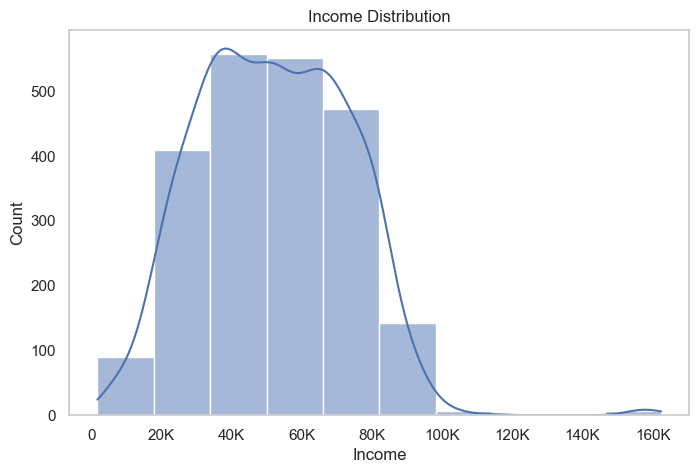

In [131]:
# create a distribution plot using 
import matplotlib.ticker as ticker
# Define a function to format the x-axis labels
def format_func(value, tick_number):
    if value >= 1000:
        value = int(value / 1000)
        return f'{value}K'
    else:
        return int(value)

# Create the displot with customized x-axis labels
sns.set(style='whitegrid')
fig, ax = plt.subplots(figsize=(8, 5))
sns.histplot(data=df, x='Income', bins=10, kde=True, ax=ax)
ax.xaxis.set_major_formatter(ticker.FuncFormatter(format_func))
ax.set_xlabel('Income')
ax.set_ylabel('Count')
ax.grid(axis='y')  # Remove  grid line
ax.grid(axis='x')  # Remove  grid line
plt.title('Income Distribution')
plt.show()


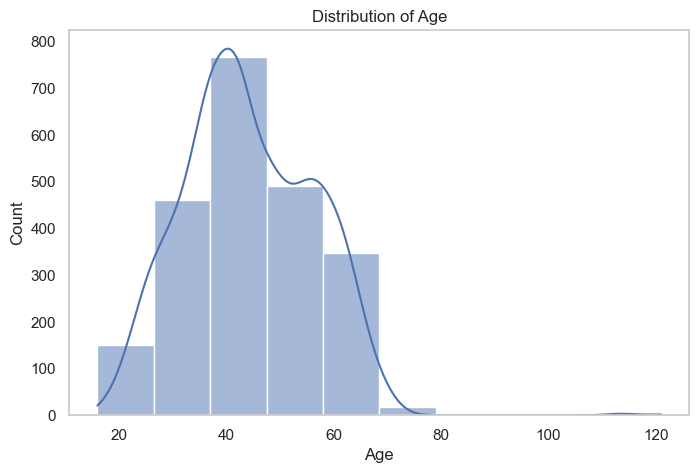

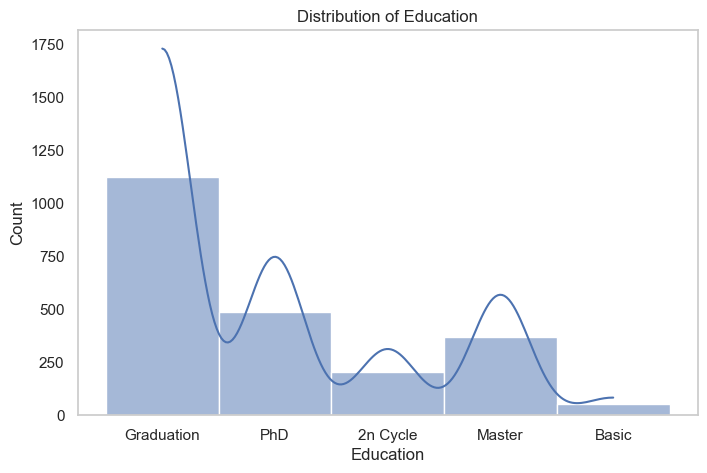

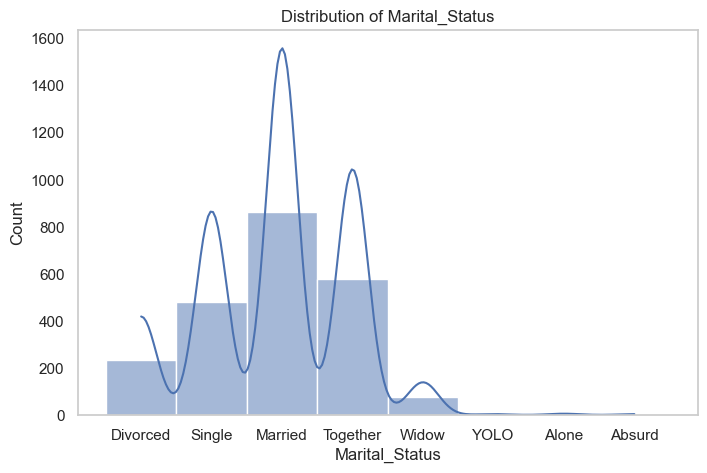

In [132]:
# create distrbution plot for each sector 
columns = ['Age', 'Education', 'Marital_Status']
for i in columns: 
    sns.set(style='whitegrid')
    fig, ax = plt.subplots(figsize=(8, 5))
    sns.histplot(df[i], bins=10, kde=True, ax=ax)
    ax.set_xlabel(i)
    ax.set_ylabel('Count')
    ax.grid(axis='y')  # Remove  grid line
    ax.grid(axis='x')  # Remove  grid line
    plt.title('Distribution of '+ i )
    plt.show()

In [133]:
# based on the four histgram graph above, we could notice some outliers from this dataset. 
# Now we will look into these outliers and remove those outliers. 

In [134]:
df['Year_Birth'].sort_values(ascending=True)
#find the customer information whose age is greater than 100
df.query('Age > 100')

,ID,Year_Birth,Age,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country
513,11004,1893,121,2n Cycle,Single,60182.0,0,1,2014-05-17,23,8,0,5,7,0,2,1,1,0,2,4,0,0,0,0,0,0,0,Saudi Arabia
827,1150,1899,114,PhD,Together,83532.0,0,0,2013-09-26,36,755,144,562,104,64,224,1,4,6,4,1,0,0,1,0,0,0,0,Spain
2233,7829,1900,113,2n Cycle,Divorced,36640.0,1,0,2013-09-26,99,15,6,8,7,4,25,1,2,1,2,5,0,0,0,0,0,0,1,India


In [135]:
# check the outlier data group with marital status absurd and yolo 
df.loc[main_df['Marital_Status'] == 'Absurd']

,ID,Year_Birth,Age,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country
1068,4369,1957,57,Master,Absurd,65487.0,0,0,2014-01-10,48,240,67,500,199,0,163,3,3,5,6,2,0,0,0,0,0,0,0,Canada
1339,7734,1993,19,Graduation,Absurd,79244.0,0,0,2012-12-19,58,471,102,125,212,61,245,1,4,10,7,1,0,0,1,1,0,1,0,Australia


In [136]:
df.loc[main_df['Marital_Status'] == 'YOLO']

,ID,Year_Birth,Age,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country
103,492,1973,39,PhD,YOLO,48432.0,0,1,2012-10-18,3,322,3,50,4,3,42,5,7,1,6,8,0,0,0,0,0,0,0,Canada
104,11133,1973,39,PhD,YOLO,48432.0,0,1,2012-10-18,3,322,3,50,4,3,42,5,7,1,6,8,0,0,0,0,0,1,0,India


 based on the infomration above, we could know the marital status YOLO is a duplicated customer data. 
 now remove the dupolicated one save the last customer data since it has value of campaign response for the last round 
 which might indicates that this is the latest status of this customer.

In [137]:
df = df.drop(df[df['ID'] == 492].index)

for future analysis I will move absurd and YOLO group to signle, as weel as divorced and widow.
I will move married and togerher to new group : relationship 
this step is to reduce the dimension during analysis. 

In [138]:
df['Marital_Status'].value_counts()

Marital_Status
Married     864
Together    579
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          1
Name: count, dtype: int64

In [139]:
# Change 'Alone' to 'Single' in the 'Marital_Status' column
df['Marital_Status'] = df['Marital_Status'].replace(['Alone', 'Divorced', 'Widow','YOLO', 'Absurd'], 'Single')
df['Marital_Status'] = df['Marital_Status'].replace(['Married', 'Together'], 'Relationship')

In [140]:
#check if the marital staus have been successfully transformed. 
df['Marital_Status'].value_counts()

Marital_Status
Relationship    1443
Single           795
Name: count, dtype: int64

### **Explore relationship between customer demographics** ###
Study the relationship between customer demographics (e.g., income, education, marital status) and their purchase habits (e.g., spending on wine, fruits, meat, fish, sweets, gold products).

##### Income VS Purchase Habit #####

In [152]:
# Rearrange customer into different group based on the income 
# Define income group bins and labels
income_bins = [0, 36000, 52000, 69000, 163000]
income_labels = ['Low', 'Lower-Medium', 'Upper-Medium', 'High']

# Create a new column 'Income_Group' based on income bins
df['Income_Group'] = pd.cut(df['Income'], bins=income_bins, labels=income_labels, right=False)

In [153]:
df.columns

Index(['ID', 'Year_Birth', 'Age', 'Education', 'Marital_Status', 'Income',
       'Kidhome', 'Teenhome', 'Dt_Customer', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Response', 'Complain', 'Country', 'Income_Group'],
      dtype='object')

In [169]:
sum_income_category = df.groupby('Income_Group')[['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']].sum().reset_index()

In [186]:
sum_income_category 

,Income_Group,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,MntWines_percentage,MntFruits_percentage,MntMeatProducts_percentage,MntFishProducts_percentage,MntSweetProducts_percentage,MntGoldProds_percentage
0,Low,13045,3352,13228,4945,3358,9744,1.917015,5.691002,3.537844,5.883753,5.539700,9.886865
1,Lower-Medium,77612,5079,30974,8223,5519,16851,11.405395,8.623090,8.284033,9.784044,9.104707,17.098067
2,Upper-Medium,244038,17188,92731,22657,16354,32359,35.862363,29.181664,24.801016,26.958177,26.979230,32.833443
3,High,345790,33281,236967,48220,35386,39601,50.815227,56.504244,63.377106,57.374026,58.376363,40.181624


##### graph to show the total amount of purchase of different income group per each category #####

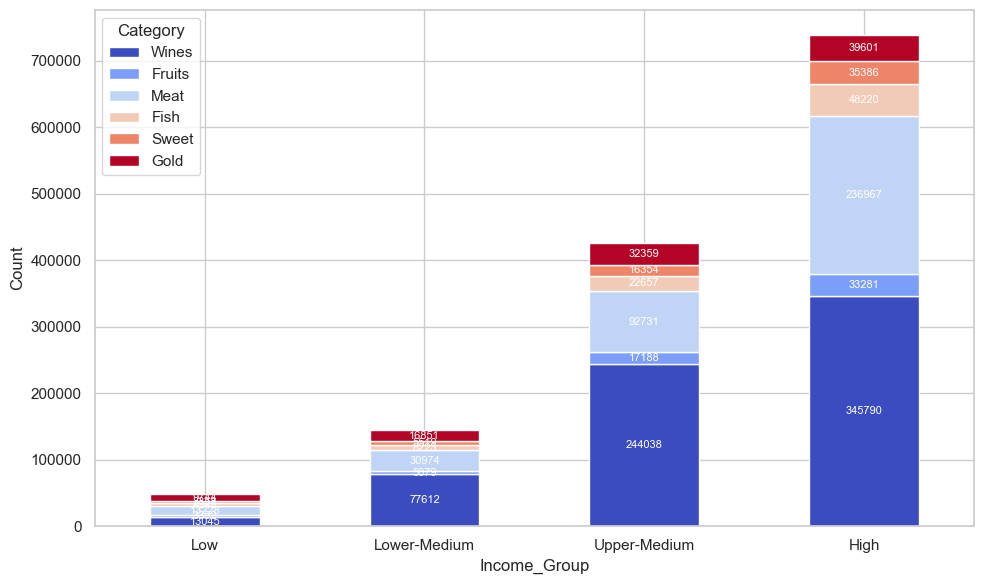

In [189]:
# Choose columns to plot
columns_to_plot = ['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']

# Plotting chosen columns
fig, ax1 = plt.subplots(figsize=(10, 6))
sum_income_category.set_index('Income_Group')[columns_to_plot].plot(kind='bar', stacked=True, figsize=(10, 6), colormap='coolwarm', ax=ax1)

# Plotting stacked bar plot
ax1.set_xlabel('Income_Group')  # Set x-axis label
ax1.set_ylabel('Count')
legend_labels = ['Wines', 'Fruits', 'Meat','Fish', 'Sweet', 'Gold']
ax1.legend(legend_labels, title='Category', loc='upper left')


# Set x-axis ticks and labels
ax1.set_xticks(range(len(sum_income_category)))
ax1.set_xticklabels(sum_income_category['Income_Group'], rotation=0)

# Annotate points on the barplot 
for p in ax1.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    if height > 4:  # Only annotate if height is greater than 4
        ax1.annotate(f'{int(round(height))}', (x + width/2, y + height/2),
                     ha='center', va='center', fontsize=8, color='white')


plt.tight_layout()
plt.show()

##### graph to show the percentage of purchase of different income group per each category #####

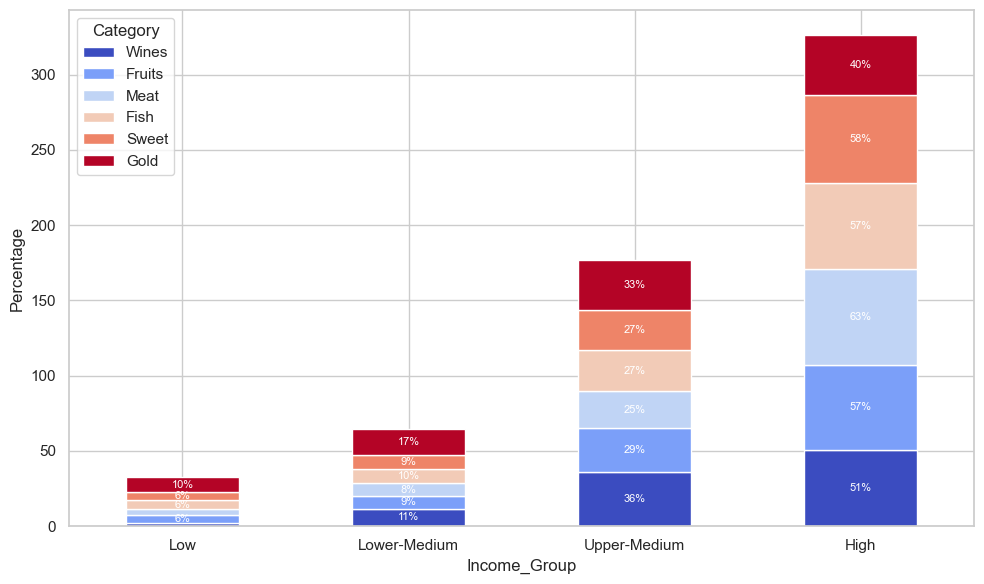

In [197]:
# Calculate percentages for each category within each income group 
# this calcualte the percentage of purchase made within different categories vs the total wine purchase 
categories = ['MntWines', 'MntFruits', 'MntMeatProducts','MntFishProducts', 'MntSweetProducts', 'MntGoldProds']

for category in categories:
    sum_income_category[category + '_percentage'] = (sum_income_category[category] / sum_income_category[category].sum()) * 100

# Plotting stacked bar plot of percentages
fig, ax2 = plt.subplots(figsize=(10, 6))
sum_income_category.set_index('Income_Group')[[col + '_percentage' for col in categories]].plot(kind='bar', stacked=True, ax=ax2, colormap='coolwarm')

# Annotate points on the barplot 
for p in ax2.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    if height > 4:  # Only annotate if height is greater than 4
        ax2.annotate(f'{int(round(height))}''%', (x + width/2, y + height/2),
                     ha='center', va='center', fontsize=8, color='white')

ax2.set_xticks(range(len(sum_income_category)))
ax2.set_xticklabels(sum_income_category['Income_Group'], rotation=0)
ax2.set_xlabel('Income_Group')
ax2.set_ylabel('Percentage')
ax2.legend(legend_labels, title='Category', loc='upper left')


plt.tight_layout()
plt.show()


##### graph to show the absolute total amount of purchase of different income group per each category（to be done) #####

In [ ]:
# Calculate percentages for each category within each income group 
# this calcualte the percentage of purchase made within different categories vs the total wine purchase 
categories = ['MntWines', 'MntFruits', 'MntMeatProducts','MntFishProducts', 'MntSweetProducts', 'MntGoldProds']

for category in categories:
    sum_income_category[category + '_abs'] = (sum_income_category[category] / sum_income_category[category].sum()) * 100

# Plotting stacked bar plot of percentages
fig, ax3 = plt.subplots(figsize=(10, 6))
sum_income_category.set_index('Income_Group')[[col + '_percentage' for col in categories]].plot(kind='bar', stacked=True, ax=ax3, colormap='coolwarm')

# Annotate points on the barplot 
for p in ax3.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    if height > 4:  # Only annotate if height is greater than 4
        ax3.annotate(f'{int(round(height))}''%', (x + width/2, y + height/2),
                     ha='center', va='center', fontsize=8, color='white')

ax3.set_xticks(range(len(sum_income_category)))
ax3.set_xticklabels(sum_income_category['Income_Group'], rotation=0)
ax3.set_xlabel('Income_Group')
ax3.set_ylabel('Percentage')
ax3.legend(legend_labels, title='Category', loc='upper left')


plt.tight_layout()
plt.show()


#### explore purchase category within different income group ####

In [234]:
avg_income_category = df.groupby('Income_Group')[['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']].mean().reset_index()

In [200]:
avg_income_category

,Income_Group,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,Low,22.414089,5.759450,22.728522,8.496564,5.769759,16.742268
1,Lower-Medium,137.123675,8.973498,54.724382,14.528269,9.750883,29.772085
2,Upper-Medium,446.138940,31.422303,169.526508,41.420475,29.897623,59.157221
3,High,636.813996,61.290976,436.403315,88.802947,65.167587,72.930018


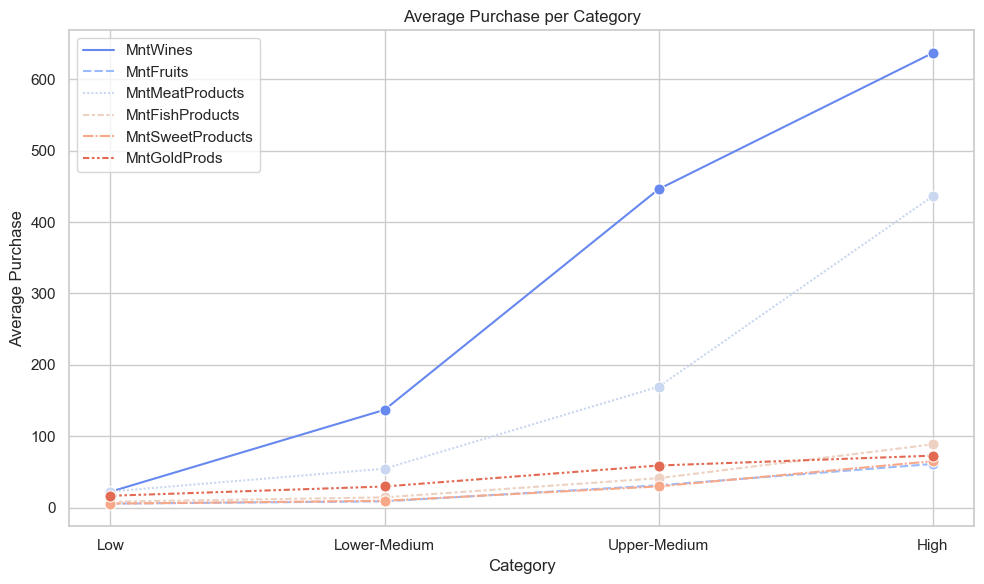

In [230]:
from matplotlib.colors import ListedColormap
# Plotting line plot with coolwarm color palette
fig, ax4 = plt.subplots(figsize=(10, 6))
sns.lineplot(data=avg_income_category, palette='coolwarm', marker='o', linestyle='-', markersize=8)


# Annotate points on the barplot 
for p in ax4.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    if height > 4:  # Only annotate if height is greater than 4
        ax4.annotate(f'{int(round(height))}', (x + width/2, y + height/2),
                     ha='center', va='center', fontsize=8, color='white')
# Set x-axis ticks and labels
ax4.set_xticks(range(len(avg_income_category)))
ax4.set_xticklabels(avg_income_category['Income_Group'], rotation=0)
        
#ax4.legend(legend_labels, title='Category', loc='upper left')
plt.xlabel('Category')
plt.ylabel('Average Purchase')
plt.title('Average Purchase per Category')
plt.tight_layout()
plt.show()


#### conclsusion ####

1. **Wine Consumption Increases with Income:**
   There is a clear trend where the average purchase of wines (MntWines) increases with higher income groups. The Low-income group has the lowest average wine purchase amount, while the High-income group has the highest.
2. **Fruits Consumption Varies Across Income Groups:** The average purchase of fruits (MntFruits) also shows variation across income groups. While the Lower-Medium income group has a relatively low average purchase of fruits, both the Upper-Medium and High-income groups show higher average purchases of fruits.
3. **Meat and Fish Products Follow Income Levels:** The purchase of meat products (MntMeatProducts) and fish products (MntFishProducts) tends to increase with income levels. The High-income group shows the highest average purchase amounts for both meat and fish products.
4. **Sweets and Gold Products Show Similar Trends:** Similar to other categories, the average purchase of sweet products (MntSweetProducts) and gold products (MntGoldProds) also increases with income. Higher-income groups tend to spend more on these luxury items.
5. **Overall Spending Pattern: There is a general trend of increased spending on various product categories as income levels rise. This aligns with the concept of disposable income and consumer behavior, where individuals with higher incomes tend to spend more on luxury items and higher-priced goods.**



#### explore purchase category within different education group ####

In [237]:
avg_education_category = df.groupby('Education')[['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']].mean().reset_index()

In [244]:
avg_education_category

,Education,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,2n Cycle,198.182266,28.955665,141.256158,47.482759,34.251232,46.399015
1,Basic,7.240741,11.111111,11.444444,17.055556,12.111111,22.833333
2,Graduation,284.513321,30.789520,179.632327,43.181172,31.394316,50.883659
3,Master,333.075676,21.654054,163.378378,32.100000,21.175676,40.397297
4,PhD,404.665979,20.084536,168.847423,26.775258,20.257732,32.290722


In [240]:
sum_education_category = df.groupby('Marital_S')[['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']].sum().reset_index()

In [245]:
sum_education_category

,Education,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,2n Cycle,40231,5878,28675,9639,6953,9419
1,Basic,391,600,618,921,654,1233
2,Graduation,320362,34669,202266,48622,35350,57295
3,Master,123238,8012,60450,11877,7835,14947
4,PhD,196263,9741,81891,12986,9825,15661


In [247]:
sum_education_category

,Education,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,2n Cycle,40231,5878,28675,9639,6953,9419
1,Basic,391,600,618,921,654,1233
2,Graduation,320362,34669,202266,48622,35350,57295
3,Master,123238,8012,60450,11877,7835,14947
4,PhD,196263,9741,81891,12986,9825,15661


#### Conclusion ####

1. **Education Level and Purchase Behavior**:
Higher Education, Higher Spending: There is a noticeable trend where individuals with higher education levels tend to spend more across all product categories compared to those with basic education. This aligns with the general assumption that higher education may correlate with higher income and purchasing power.

2. **Product Preferences Across Education Levels**:
Wine Consumption: Graduates and those in the 2n Cycle (assumed to be master's level) exhibit significantly higher spending on wine (MntWines) compared to other education levels. This could indicate a preference for wine among individuals with higher education qualifications.

3. **Meat Products**: Graduates also show the highest spending on meat products (MntMeatProducts), which might reflect a higher standard of living or dietary preferences associated with higher education and income levels.
Gold Products: Graduates and those in the 2n Cycle also have higher spending on gold products (MntGoldProds), suggesting a tendency towards luxury or investment-oriented purchases in these groups.

4. **Differences in Sweet and Fish Products Spending**:
Sweet and Fish Products: While there are variations, there isn't a consistent pattern across education levels for spending on sweet products (MntSweetProducts) and fish products (MntFishProducts). This could indicate that factors other than education level play a stronger role in determining spending on these categories.

5. **Impact of Advanced Education (Master's and PhD)**:
Master's and PhD Levels: Individuals with master's and PhD degrees tend to have higher spending across most categories compared to those with basic or lower education levels. This suggests that advanced education may correlate with higher disposable income and a more affluent lifestyle.

6. **Further Analysis Opportunities**:
Segmented Marketing Strategies: Businesses can leverage these insights to tailor marketing strategies and product offerings based on the education level of their target audience. For example, they may focus premium wine promotions towards graduate and 2n Cycle individuals.
7. **Customer Behavior Studies**: Further analysis can be conducted to understand the underlying factors driving purchase behavior across different education levels, such as income levels, lifestyle preferences, and cultural influences.

#### explore purchase category within different marital group ####

In [248]:
Marital_Status_category = df.groupby('Marital_Status').agg(
    {'MntWines': ['sum', 'mean'],
     'MntFruits': ['sum', 'mean'],
     'MntMeatProducts': ['sum', 'mean'],
     'MntFishProducts': ['sum', 'mean'],
     'MntSweetProducts': ['sum', 'mean'],
     'MntGoldProds': ['sum', 'mean']}
).reset_index()

In [249]:
Marital_Status_category

Marital_Status MntWines             MntFruits            MntMeatProducts  \
                      sum        mean       sum       mean             sum   
0   Relationship   436701  302.634096     36924  25.588358          236311   
1         Single   243784  306.646541     21976  27.642767          137589   

              MntFishProducts            MntSweetProducts             \
         mean             sum       mean              sum       mean   
0  163.763687           53176  36.851005            38220  26.486486   
1  173.067925           30869  38.828931            22397  28.172327   

  MntGoldProds             
           sum       mean  
0        61924  42.913375  
1        36631  46.076730

1. **MntWines Analysis:**
        Relationship: The sum of wine purchases (MntWines_sum) for individuals in a relationship is 436,701, with an average (MntWines_mean) of approximately 302.63. This indicates a substantial total expenditure on wines.
        Single: Singles have a lower sum of wine purchases (243,784) compared to those in a relationship. However, their average wine purchase amount (306.65) is slightly higher, suggesting a relatively consistent spending pattern per person.

2. **MntFruits Analysis:**
        Relationship: The sum of fruit purchases (MntFruits_sum) for individuals in a relationship is 36,924, with an average (MntFruits_mean) of approximately 25.59. This category shows a relatively lower expenditure compared to other product categories.
        Single: Singles have a slightly lower sum of fruit purchases (21,976) compared to those in a relationship. However, their average fruit purchase amount (27.64) is slightly higher, indicating a relatively consistent spending pattern per person.

3. **MntMeatProducts Analysis:**
        Relationship: Individuals in a relationship have a significant sum of meat product purchases (MntMeatProducts_sum) at 236,311, with an average (MntMeatProducts_mean) of approximately 163.76. This suggests a substantial preference for meat products in this group.
        Single: Singles also show a considerable sum of meat product purchases (137,589) but have a slightly higher average purchase amount (173.07) per person compared to those in a relationship.

4. **MntFishProducts, MntSweetProducts, and MntGoldProds Analysis:**
        The analysis for these categories (fish products, sweet products, and gold products) follows a similar pattern, with individuals in a relationship generally having higher total sums but slightly lower average purchase amounts per person compared to singles.

Overall, the analysis indicates differences in purchasing behavior between individuals in a relationship and singles across various product categories. The sum values reflect total expenditure, while the mean values provide insights into average spending per person, highlighting different preferences and consumption patterns based on marital status.

#### explore purchase category of the number of children at home ####

In [253]:
# create a new column to calculate the total number of kids per each customer 
df['Children'] = df['Teenhome'] + df['Kidhome']

,ID,Year_Birth,Age,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Country,Income_Group,Children
0,1826,1970,44,Graduation,Single,84835.0,0,0,2014-06-16,0,189,104,379,111,189,218,1,4,4,6,1,0,0,0,0,0,1,0,Spain,High,0
1,1,1961,53,Graduation,Single,57091.0,0,0,2014-06-15,0,464,5,64,7,0,37,1,7,3,7,5,0,0,0,0,1,1,0,Canada,Upper-Medium,0
2,10476,1958,56,Graduation,Relationship,67267.0,0,1,2014-05-13,0,134,11,59,15,2,30,1,3,2,5,2,0,0,0,0,0,0,0,USA,Upper-Medium,1
3,1386,1967,47,Graduation,Relationship,32474.0,1,1,2014-05-11,0,10,0,1,0,0,0,1,1,0,2,7,0,0,0,0,0,0,0,Australia,Low,2
4,5371,1989,25,Graduation,Single,21474.0,1,0,2014-04-08,0,6,16,24,11,0,34,2,3,1,2,7,1,0,0,0,0,1,0,Spain,Low,1


In [261]:
df['Children'].unique()

array([0, 1, 2, 3])

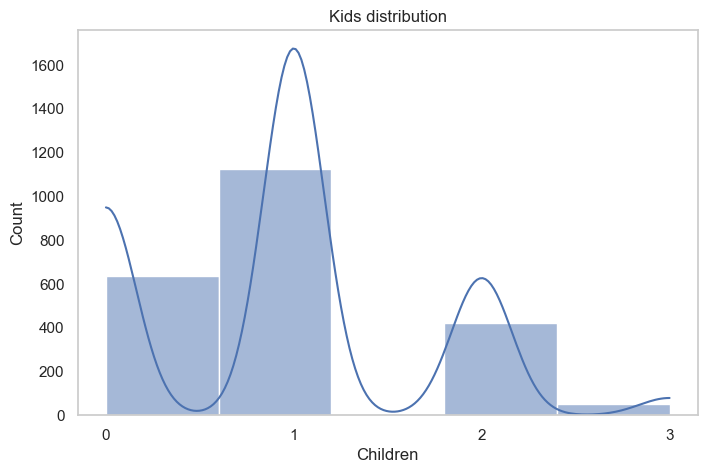

In [264]:
# study the distribution first 
# create a distribution plot using 
import matplotlib.ticker as ticker

# Create the distribution plot with customized x-axis labels
sns.set(style='whitegrid')
fig, ax5 = plt.subplots(figsize=(8, 5))
sns.histplot(data=df, x='Children', bins=5, kde=True, ax=ax5)
ax5.set_xlabel('Children')
ax5.set_ylabel('Count')
ax5.grid(axis='y')  # Remove y-axis grid lines
ax5.grid(axis='x')  # Remove x-axis grid lines

# Set x-axis to show only integer ticks (0, 1, 2, 3)
ax5.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))

plt.title('Kids distribution')
plt.show()


In [265]:
kid_category = df.groupby('Children').agg(
    {'MntWines': ['sum', 'mean'],
     'MntFruits': ['sum', 'mean'],
     'MntMeatProducts': ['sum', 'mean'],
     'MntFishProducts': ['sum', 'mean'],
     'MntSweetProducts': ['sum', 'mean'],
     'MntGoldProds': ['sum', 'mean']}
).reset_index()

In [266]:
kid_category

Children MntWines             MntFruits            MntMeatProducts  \
                sum        mean       sum       mean             sum   
0        0   310901  487.305643     33404  52.357367          237725   
1        1   300891  267.221137     21813  19.372114          111185   
2        2    59610  141.591449      3317   7.878860           21597   
3        3     9083  171.377358       366   6.905660            3393   

              MntFishProducts            MntSweetProducts             \
         mean             sum       mean              sum       mean   
0  372.609718           48837  76.547022            33853  53.061129   
1   98.743339           30039  26.677620            22889  20.327709   
2   51.299287            4794  11.387173             3524   8.370546   
3   64.018868             375   7.075472              351   6.622642   

  MntGoldProds             
           sum       mean  
0        40927  64.148903  
1        45940  40.799290  
2        10702  25.420428  
3          986  18.603774

In [296]:
# this step calculates the average value of different purchase category based on kids at home
avg_kid_category = df.groupby('Children')[['MntWines','MntFruits', 'MntMeatProducts', 
                                           'MntFishProducts', 'MntSweetProducts','MntGoldProds']].mean().reset_index()

In [298]:
# Calculate Pearson correlation coefficient( this is based on the average value ) 
# list all the columns that need to be printed out 
numberic_columns = ['MntWines','MntFruits', 'MntMeatProducts','MntFishProducts', 'MntSweetProducts','MntGoldProds']

correlation_coefficients = {}
for col in numberic_columns:
    correlation_coefficient = avg_kid_category['Children'].corr(avg_kid_category[col])
    correlation_coefficients[col] = correlation_coefficient

for col, coef in correlation_coefficients.items():
    print(f"Pearson Correlation Coefficient between 'Children' and '{col}': {coef}")


Pearson Correlation Coefficient between 'Children' and 'MntWines': -0.8859067497465795
Pearson Correlation Coefficient between 'Children' and 'MntFruits': -0.8980588556269743
Pearson Correlation Coefficient between 'Children' and 'MntMeatProducts': -0.8268258951930764
Pearson Correlation Coefficient between 'Children' and 'MntFishProducts': -0.9059154177603721
Pearson Correlation Coefficient between 'Children' and 'MntSweetProducts': -0.9073450572776075
Pearson Correlation Coefficient between 'Children' and 'MntGoldProds': -0.9716718412432008


In [303]:
# take the dataframe with number of kids at home and then do the correlation graph 
test_correlation_coefficients = {}
for col in numberic_columns:
    test_correlation_coefficient = df['Children'].corr(df[col])
    test_correlation_coefficients[col] = test_correlation_coefficient

for col, coef in test_correlation_coefficients.items():
    print(f"Pearson Correlation Coefficient between 'Children' and '{col}': {coef}")


Pearson Correlation Coefficient between 'Children' and 'MntWines': -0.35194616349437186
Pearson Correlation Coefficient between 'Children' and 'MntFruits': -0.39486628265469403
Pearson Correlation Coefficient between 'Children' and 'MntMeatProducts': -0.5022528004147323
Pearson Correlation Coefficient between 'Children' and 'MntFishProducts': -0.4255337113920417
Pearson Correlation Coefficient between 'Children' and 'MntSweetProducts': -0.3831653253142724
Pearson Correlation Coefficient between 'Children' and 'MntGoldProds': -0.26609922483976045


#### Conclusion ####

1. **Number of Children vs. Total Purchase Amounts:**
There is a noticeable trend where households with fewer children tend to have higher total purchase amounts across most product categories compared to households with more children.pecifically, households with 0 or 1 child have higher total purchase amounts for wines (MntWines), meat products (MntMeatProducts), sweet products (MntSweetProducts), and gold products (MntGoldProds) compared to households with 2 or 3 children.
2.  **Number of Children vs. Average Purchase Amounts:**
        When looking at average purchase amounts (mean), households with fewer children generally have higher average spending per person across most categories.
        This suggests that households with fewer children may have a higher budget per person for purchasing various products.

3. **Specific Purchase Patterns:**
        Wines (MntWines): Households with 0 children have the highest total purchase amount and average spending per person on wines, indicating a potential correlation between family size and wine consumption habits.
        Meat Products (MntMeatProducts): Similar to wines, households with fewer children have higher total purchase amounts and average spending on meat products.
        Fish Products (MntFishProducts): Although not as pronounced as other categories, households with 0 children tend to have higher total and average purchase amounts for fish products compared to those with more children.
        Sweet Products (MntSweetProducts) and Gold Products (MntGoldProds): Similar trends can be observed for these categories, with households with fewer children showing higher spending patterns.

4. **Potential Insights:**
        These insights can be used by marketers or businesses to tailor their marketing strategies or product offerings based on the family size demographics.
        It may also indicate varying consumer behaviors and preferences within different household compositions.

**Overall, the analysis suggests a relationship between the number of children at home and purchase habits, with households having fewer children generally exhibiting higher purchase amounts and average spending per person across various product categories.**


## **Customer analysis** ##

In [318]:
# calculate total spending 
df['total_spending'] = df[['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']].sum(axis=1)

In [323]:
# this is to elimitate the impacts of golds product which may increase the total spending  
df['total_spending_no_golds'] = df[['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts']].sum(axis=1)

In [322]:
df.total_spending.describe()

count    2238.000000
mean      606.122431
std       602.396389
min         5.000000
25%        69.000000
50%       396.000000
75%      1046.500000
max      2525.000000
Name: total_spending, dtype: float64

In [324]:
df.total_spending_no_golds.describe()

count    2238.000000
mean      562.085344
std       576.757287
min         4.000000
25%        55.000000
50%       341.000000
75%       964.000000
max      2491.000000
Name: total_spending_no_golds, dtype: float64

In [326]:
df['Spend_without_gold_proportion'] = df.total_spending_no_golds / df.total_spending
df['Spend_without_gold_proportion'].describe()

count    2238.000000
mean        0.879827
std         0.109025
min         0.105850
25%         0.830339
50%         0.914059
75%         0.961905
max         1.000000
Name: Spend_without_gold_proportion, dtype: float64

In [327]:
df['Spend_gold_proportion'] = df.MntGoldProds / df.total_spending
df['Spend_gold_proportion'].describe()

count    2238.000000
mean        0.120173
std         0.109025
min         0.000000
25%         0.038095
50%         0.085941
75%         0.169661
max         0.894150
Name: Spend_gold_proportion, dtype: float64

In [329]:
purchases_products = ['MntWines','MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts','MntGoldProds']
for column in purchases_products:
    df[column + '_proportion'] = df[column] / df.total_spending_no_golds
    
df[[item + '_proportion' for item in purchases_products]].describe()

,MntWines_proportion,MntFruits_proportion,MntMeatProducts_proportion,MntFishProducts_proportion,MntSweetProducts_proportion,MntGoldProds_proportion
count,2238.000000,2238.000000,2238.000000,2238.000000,2238.000000,2238.000000
mean,0.510133,0.059399,0.283784,0.085487,0.061197,0.161585
std,0.238247,0.072698,0.136786,0.100172,0.079863,0.254035
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.334983,0.009429,0.179946,0.013292,0.009252,0.039604
50%,0.516617,0.034905,0.272727,0.051837,0.038057,0.094021
75%,0.701592,0.079351,0.374879,0.121212,0.081495,0.204328
max,0.972222,0.762712,0.997687,0.750000,0.956364,8.447368


In [331]:
#calculate the total campaign accepted by each customer 
df['Campaigns_Accepted'] = df[['AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1','AcceptedCmp2', 'Response']].sum(axis=1)

In [332]:
df['total_purchase'] = df[['NumDealsPurchases', 'NumWebPurchases','NumCatalogPurchases', 'NumStorePurchases']].sum(axis=1)

In [333]:
purchases_columns = ['NumDealsPurchases', 'NumWebPurchases','NumCatalogPurchases', 'NumStorePurchases']
for column in purchases_columns:
    df[column + '_proportion'] = (df[column] / df.total_purchase).fillna(0)
    
df[[item + '_proportion' for item in purchases_columns]].describe()

,NumDealsPurchases_proportion,NumWebPurchases_proportion,NumCatalogPurchases_proportion,NumStorePurchases_proportion
count,2238.000000,2238.000000,2238.000000,2238.000000
mean,0.180307,0.266769,0.141805,0.409332
std,0.111245,0.100232,0.127281,0.120776
min,0.000000,0.000000,0.000000,0.000000
25%,0.076923,0.200000,0.000000,0.333333
50%,0.166667,0.259259,0.120000,0.411765
75%,0.250000,0.333333,0.222222,0.500000
max,1.000000,1.000000,1.000000,1.000000


In [334]:
# calculate proportion of discount purchase 
# adding 1 avioid division by zero errors.
df['discount_purchase_proportion'] = df.NumDealsPurchases / (df.total_purchase + 1)
df.discount_purchase_proportion.describe()

count    2238.000000
mean        0.163064
std         0.100319
min         0.000000
25%         0.071429
50%         0.153846
75%         0.235294
max         0.937500
Name: discount_purchase_proportion, dtype: float64

In [335]:
# calculate average spending per each purchase  
# adding 0.001 avioid division by zero errors.
df['avg_spend_per_purchase'] = df.total_spending / (df.total_purchase + 0.001)

In [336]:
# calculate the proportion of purchase made by web vs web visit 
df['web_cr'] = df.NumWebPurchases / (df.NumWebVisitsMonth + 1)
df['web_cr'].describe()

count    2238.000000
mean        0.802795
std         0.873555
min         0.000000
25%         0.285714
50%         0.666667
75%         1.222222
max        23.000000
Name: web_cr, dtype: float64

In [352]:
# remove unrelated dimension 
df.drop(['ID','Dt_Customer', 'Kidhome', 'Teenhome', 'Country'], axis=1, inplace=True)
#df.drop(['Country'], axis=1, inplace=True)
#df.drop(['Year_Birth'], axis=1, inplace=True)

In [353]:
df.head()

,Age,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Income_Group,Children,total_spending,total_spending_no_golds,Spend_without_gold_proportion,Spend_gold_proportion,MntWines_proportion,MntFruits_proportion,MntMeatProducts_proportion,MntFishProducts_proportion,MntSweetProducts_proportion,MntGoldProds_proportion,Campaigns_Accepted,total_purchase,NumDealsPurchases_proportion,NumWebPurchases_proportion,NumCatalogPurchases_proportion,NumStorePurchases_proportion,discount_purchase_proportion,avg_spend_per_purchase,web_cr
0,44,Graduation,Single,84835.0,0,189,104,379,111,189,218,1,4,4,6,1,0,0,0,0,0,1,0,High,0,1190,972,0.816807,0.183193,0.194444,0.106996,0.389918,0.114198,0.194444,0.224280,1,15,0.066667,0.266667,0.266667,0.400000,0.062500,79.328045,2.000000
1,53,Graduation,Single,57091.0,0,464,5,64,7,0,37,1,7,3,7,5,0,0,0,0,1,1,0,Upper-Medium,0,577,540,0.935875,0.064125,0.859259,0.009259,0.118519,0.012963,0.000000,0.068519,2,18,0.055556,0.388889,0.166667,0.388889,0.052632,32.053775,1.166667
2,56,Graduation,Relationship,67267.0,0,134,11,59,15,2,30,1,3,2,5,2,0,0,0,0,0,0,0,Upper-Medium,1,251,221,0.880478,0.119522,0.606335,0.049774,0.266968,0.067873,0.009050,0.135747,0,11,0.090909,0.272727,0.181818,0.454545,0.083333,22.816108,1.000000
3,47,Graduation,Relationship,32474.0,0,10,0,1,0,0,0,1,1,0,2,7,0,0,0,0,0,0,0,Low,2,11,11,1.000000,0.000000,0.909091,0.000000,0.090909,0.000000,0.000000,0.000000,0,4,0.250000,0.250000,0.000000,0.500000,0.200000,2.749313,0.125000
4,25,Graduation,Single,21474.0,0,6,16,24,11,0,34,2,3,1,2,7,1,0,0,0,0,1,0,Low,1,91,57,0.626374,0.373626,0.105263,0.280702,0.421053,0.192982,0.000000,0.596491,2,8,0.250000,0.375000,0.125000,0.250000,0.222222,11.373578,0.375000


#### **feacture encoding** ####

In [354]:
encode = pd.get_dummies(df)
encode

,Age,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Children,total_spending,total_spending_no_golds,Spend_without_gold_proportion,Spend_gold_proportion,MntWines_proportion,MntFruits_proportion,MntMeatProducts_proportion,MntFishProducts_proportion,MntSweetProducts_proportion,MntGoldProds_proportion,Campaigns_Accepted,total_purchase,NumDealsPurchases_proportion,NumWebPurchases_proportion,NumCatalogPurchases_proportion,NumStorePurchases_proportion,discount_purchase_proportion,avg_spend_per_purchase,web_cr,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Relationship,Marital_Status_Single,Income_Group_Low,Income_Group_Lower-Medium,Income_Group_Upper-Medium,Income_Group_High
0,44,84835.0,0,189,104,379,111,189,218,1,4,4,6,1,0,0,0,0,0,1,0,0,1190,972,0.816807,0.183193,0.194444,0.106996,0.389918,0.114198,0.194444,0.224280,1,15,0.066667,0.266667,0.266667,0.400000,0.062500,79.328045,2.000000,False,False,True,False,False,False,True,False,False,False,True
1,53,57091.0,0,464,5,64,7,0,37,1,7,3,7,5,0,0,0,0,1,1,0,0,577,540,0.935875,0.064125,0.859259,0.009259,0.118519,0.012963,0.000000,0.068519,2,18,0.055556,0.388889,0.166667,0.388889,0.052632,32.053775,1.166667,False,False,True,False,False,False,True,False,False,True,False
2,56,67267.0,0,134,11,59,15,2,30,1,3,2,5,2,0,0,0,0,0,0,0,1,251,221,0.880478,0.119522,0.606335,0.049774,0.266968,0.067873,0.009050,0.135747,0,11,0.090909,0.272727,0.181818,0.454545,0.083333,22.816108,1.000000,False,False,True,False,False,True,False,False,False,True,False
3,47,32474.0,0,10,0,1,0,0,0,1,1,0,2,7,0,0,0,0,0,0,0,2,11,11,1.000000,0.000000,0.909091,0.000000,0.090909,0.000000,0.000000,0.000000,0,4,0.250000,0.250000,0.000000,0.500000,0.200000,2.749313,0.125000,False,False,True,False,False,True,False,True,False,False,False
4,25,21474.0,0,6,16,24,11,0,34,2,3,1,2,7,1,0,0,0,0,1,0,1,91,57,0.626374,0.373626,0.105263,0.280702,0.421053,0.192982,0.000000,0.596491,2,8,0.250000,0.375000,0.125000,0.250000,0.222222,11.373578,0.375000,False,False,True,False,False,False,True,True,False,False,False
5,56,71691.0,0,336,130,411,240,32,43,1,4,7,5,2,0,0,0,0,0,1,0,0,1192,1149,0.963926,0.036074,0.292428,0.113142,0.357702,0.208877,0.027850,0.037424,1,17,0.058824,0.235294,0.411765,0.294118,0.055556,70.113523,1.333333,False,False,False,False,True,False,True,False,False,False,True
6,60,63564.0,0,769,80,252,15,34,65,1,10,10,7,6,1,0,0,0,0,1,0,0,1215,1150,0.946502,0.053498,0.668696,0.069565,0.219130,0.013043,0.029565,0.056522,2,28,0.035714,0.357143,0.357143,0.250000,0.034483,43.391307,1.428571,True,False,False,False,False,True,False,False,False,True,False
7,47,44931.0,0,78,0,11,0,0,7,1,2,1,3,5,0,0,0,0,0,0,0,1,96,89,0.927083,0.072917,0.876404,0.000000,0.123596,0.000000,0.000000,0.078652,0,7,0.142857,0.285714,0.142857,0.428571,0.125000,13.712327,0.333333,False,False,True,False,False,True,False,False,True,False,False
8,60,65324.0,0,384,0,102,21,32,5,3,6,2,9,4,0,0,0,0,0,0,0,1,544,539,0.990809,0.009191,0.712430,0.000000,0.189239,0.038961,0.059369,0.009276,0,20,0.150000,0.300000,0.100000,0.450000,0.142857,27.198640,1.200000,False,False,False,False,True,True,False,False,False,True,False
9,60,65324.0,0,384,0,102,21,32,5,3,6,2,9,4,0,0,0,0,0,0,0,1,544,539,0.990809,0.009191,0.712430,0.000000,0.189239,0.038961,0.059369,0.009276,0,20,0.150000,0.300000,0.100000,0.450000,0.142857,27.198640,1.200000,False,False,False,False,True,True,False,False,False,True,False


In [355]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [356]:
X = scaler.fit_transform(encode)
X

array([[-0.01898978,  1.53521884, -1.69762782, ..., -0.58182192,
        -0.56875059,  1.76679002],
       [ 0.72952716,  0.23940857, -1.69762782, ..., -0.58182192,
         1.75823994, -0.56599822],
       [ 0.9790328 ,  0.71468846, -1.69762782, ..., -0.58182192,
         1.75823994, -0.56599822],
       ...,
       [-0.68433817, -0.26412842,  1.72238705, ...,  1.71873896,
        -0.56875059, -0.56599822],
       [-0.85067526,  0.64705823,  1.72238705, ..., -0.58182192,
         1.75823994, -0.56599822],
       [-0.10215833,  2.00395989,  1.72238705, ..., -0.58182192,
        -0.56875059,  1.76679002]])

In [357]:
# create a new dataframe for module fitting
X = pd.DataFrame(X)
X.columns = encode.columns
X

,Age,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Children,total_spending,total_spending_no_golds,Spend_without_gold_proportion,Spend_gold_proportion,MntWines_proportion,MntFruits_proportion,MntMeatProducts_proportion,MntFishProducts_proportion,MntSweetProducts_proportion,MntGoldProds_proportion,Campaigns_Accepted,total_purchase,NumDealsPurchases_proportion,NumWebPurchases_proportion,NumCatalogPurchases_proportion,NumStorePurchases_proportion,discount_purchase_proportion,avg_spend_per_purchase,web_cr,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Relationship,Marital_Status_Single,Income_Group_Low,Income_Group_Lower-Medium,Income_Group_Upper-Medium,Income_Group_High
0,-0.018990,1.535219,-1.697628,-0.341814,1.952865,0.938869,1.344359,3.922075,3.334240,-0.684983,-0.030233,0.457171,0.064183,-1.778301,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,-1.263884,0.969475,0.710882,-0.578164,0.578164,-1.325339,0.654860,0.776084,0.286679,1.668816,0.246852,0.620592,0.017983,-1.021759,-0.001023,0.981216,-0.077280,-1.002662,0.128982,1.370805,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,-1.347254,1.347254,-0.592832,-0.581822,-0.568751,1.766790
1,0.729527,0.239409,-1.697628,0.475144,-0.535922,-0.456602,-0.559252,-0.656091,-0.134876,-0.684983,1.049464,0.115095,0.371767,-0.129823,-0.280275,-0.283967,-0.280275,-0.262236,8.579044,2.387593,-0.097326,-1.263884,-0.048355,-0.038301,0.514204,-0.514204,1.465723,-0.689858,-1.208480,-0.724152,-0.766443,-0.366433,1.743378,0.408712,-1.121661,1.218644,0.195376,-0.169299,-1.101054,-0.045874,0.416635,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,-1.347254,1.347254,-0.592832,-0.581822,1.758240,-0.565998
2,0.979033,0.714688,-1.697628,-0.505205,-0.385087,-0.478752,-0.412820,-0.607645,-0.269040,-0.684983,-0.390132,-0.226980,-0.243401,-1.366182,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,-0.418832,-0.097326,0.065957,-0.589648,-0.591517,0.005975,-0.005975,0.403882,-0.132436,-0.122964,-0.175870,-0.653102,-0.101733,-0.502193,-0.502989,-0.803792,0.059456,0.314442,0.374447,-0.794946,-0.080042,0.225801,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,0.742250,-0.742250,-0.592832,-0.581822,1.758240,-0.565998
3,0.230516,-0.910352,-1.697628,-0.873579,-0.661619,-0.735696,-0.687380,-0.656091,-0.844032,-0.684983,-1.109930,-0.911131,-1.166152,0.694416,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,-0.418832,-0.097326,1.395799,-0.988146,-0.955703,1.102502,-1.102502,1.674929,-0.817252,-1.410370,-0.853587,-0.766443,-0.636213,-0.502193,-1.414690,0.626617,-0.167342,-1.114358,0.750886,0.368265,-0.154265,-0.776077,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,0.742250,-0.742250,1.686820,-0.581822,-0.568751,-0.565998
4,-1.599192,-1.424118,-1.697628,-0.885462,-0.259390,-0.633804,-0.486036,-0.656091,-0.192375,-0.167255,-0.390132,-0.569056,-1.166152,0.694416,3.567921,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,0.065957,-0.855313,-0.875929,-2.325251,2.325251,-1.699745,3.044808,1.003754,1.073348,-0.766443,1.712374,1.743378,-0.893718,0.626617,1.080046,-0.132058,-1.319530,0.589829,-0.122366,-0.489826,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,-1.347254,1.347254,1.686820,-0.581822,-0.568751,-0.565998
5,0.979033,0.921316,-1.697628,0.094888,2.606485,1.080631,3.705569,0.119048,-0.019877,-0.684983,-0.030233,1.483397,-0.243401,-1.366182,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,-1.263884,0.972796,1.017839,0.771551,-0.771551,-0.913978,0.739420,0.540515,1.232059,-0.417641,-0.488863,0.620592,0.278469,-1.092278,-0.314093,2.121454,-0.954162,-1.071901,0.094899,0.607469,-0.315839,-0.157243,-1.006275,-0.445054,1.901166,-1.347254,1.347254,-0.592832,-0.581822,-0.568751,1.766790
6,1.311707,0.541736

#### Higly correlated features removing ####

<Axes: >

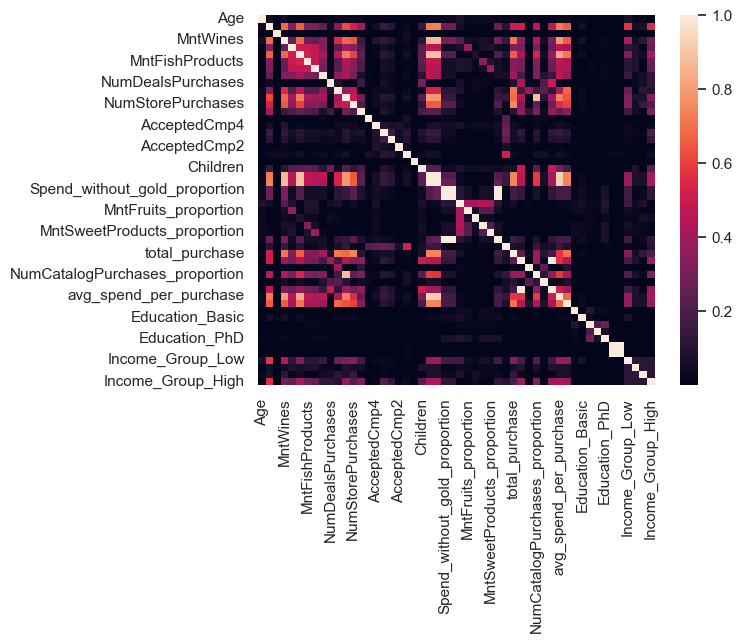

In [358]:
# Squaring the correlation coefficients can highlight nonlinear relationships between variables
# because Spearman's rank correlation is less sensitive to outliers and can capture monotonic relationships
determination_matrix = X.corr(method='spearman')**2
sns.heatmap(determination_matrix)

In [359]:
#based on Spearman's rank correlation, threshold for correlation is 0.75
for feature in determination_matrix:
    #remove the feature where correlation = itself (value 1), which is not informative for finding highly correlated features with it
    feature_correlations = determination_matrix[feature].drop(feature)
    # filter the correlated feature using 0.75
    higly_correlated_features = feature_correlations[feature_correlations >= 0.75].index
    # checks if there are any highly correlated features found for the current feature.
    if higly_correlated_features.shape[0] != 0:
        print(feature)
        for covariate in higly_correlated_features:
            print(covariate, determination_matrix.loc[feature, covariate])

MntWines
total_spending 0.8593770074889006
total_spending_no_golds 0.8751332003517616
avg_spend_per_purchase 0.78956267870868
MntMeatProducts
total_spending 0.882406239215815
total_spending_no_golds 0.8880411268513365
avg_spend_per_purchase 0.8282192449389624
NumCatalogPurchases
total_spending 0.7955657071191973
total_spending_no_golds 0.7827538203926839
NumCatalogPurchases_proportion 0.8822659643898852
NumStorePurchases
total_purchase 0.7526894504217959
total_spending
MntWines 0.8593770074889006
MntMeatProducts 0.882406239215815
NumCatalogPurchases 0.7955657071191973
total_spending_no_golds 0.9928726389540887
avg_spend_per_purchase 0.9297449328701018
total_spending_no_golds
MntWines 0.8751332003517616
MntMeatProducts 0.8880411268513365
NumCatalogPurchases 0.7827538203926839
total_spending 0.9928726389540887
avg_spend_per_purchase 0.9200569345854772
Spend_without_gold_proportion
Spend_gold_proportion 1.0
MntGoldProds_proportion 1.0
Spend_gold_proportion
Spend_without_gold_proportion 1.

In [360]:
# drop the higly correlated features
features_to_drop = [ 'Spend_total', 'Spend_without_gold', 'total_purchase','total_spending_no_golds', 
                    'avg_spend_per_purchase', 'NumCatalogPurchases', 'Spend_gold_proportion', 
                   ]


In [361]:
X.drop(features_to_drop, axis=1, inplace=True, errors='ignore')
X

,Age,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Children,total_spending,Spend_without_gold_proportion,MntWines_proportion,MntFruits_proportion,MntMeatProducts_proportion,MntFishProducts_proportion,MntSweetProducts_proportion,MntGoldProds_proportion,Campaigns_Accepted,NumDealsPurchases_proportion,NumWebPurchases_proportion,NumCatalogPurchases_proportion,NumStorePurchases_proportion,discount_purchase_proportion,web_cr,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD,Marital_Status_Relationship,Marital_Status_Single,Income_Group_Low,Income_Group_Lower-Medium,Income_Group_Upper-Medium,Income_Group_High
0,-0.018990,1.535219,-1.697628,-0.341814,1.952865,0.938869,1.344359,3.922075,3.334240,-0.684983,-0.030233,0.064183,-1.778301,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,-1.263884,0.969475,-0.578164,-1.325339,0.654860,0.776084,0.286679,1.668816,0.246852,0.620592,-1.021759,-0.001023,0.981216,-0.077280,-1.002662,1.370805,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,-1.347254,1.347254,-0.592832,-0.581822,-0.568751,1.766790
1,0.729527,0.239409,-1.697628,0.475144,-0.535922,-0.456602,-0.559252,-0.656091,-0.134876,-0.684983,1.049464,0.371767,-0.129823,-0.280275,-0.283967,-0.280275,-0.262236,8.579044,2.387593,-0.097326,-1.263884,-0.048355,0.514204,1.465723,-0.689858,-1.208480,-0.724152,-0.766443,-0.366433,1.743378,-1.121661,1.218644,0.195376,-0.169299,-1.101054,0.416635,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,-1.347254,1.347254,-0.592832,-0.581822,1.758240,-0.565998
2,0.979033,0.714688,-1.697628,-0.505205,-0.385087,-0.478752,-0.412820,-0.607645,-0.269040,-0.684983,-0.390132,-0.243401,-1.366182,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,-0.418832,-0.097326,0.065957,-0.589648,0.005975,0.403882,-0.132436,-0.122964,-0.175870,-0.653102,-0.101733,-0.502193,-0.803792,0.059456,0.314442,0.374447,-0.794946,0.225801,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,0.742250,-0.742250,-0.592832,-0.581822,1.758240,-0.565998
3,0.230516,-0.910352,-1.697628,-0.873579,-0.661619,-0.735696,-0.687380,-0.656091,-0.844032,-0.684983,-1.109930,-1.166152,0.694416,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,-0.418832,-0.097326,1.395799,-0.988146,1.102502,1.674929,-0.817252,-1.410370,-0.853587,-0.766443,-0.636213,-0.502193,0.626617,-0.167342,-1.114358,0.750886,0.368265,-0.776077,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,0.742250,-0.742250,1.686820,-0.581822,-0.568751,-0.565998
4,-1.599192,-1.424118,-1.697628,-0.885462,-0.259390,-0.633804,-0.486036,-0.656091,-0.192375,-0.167255,-0.390132,-1.166152,0.694416,3.567921,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,0.065957,-0.855313,-2.325251,-1.699745,3.044808,1.003754,1.073348,-0.766443,1.712374,1.743378,0.626617,1.080046,-0.132058,-1.319530,0.589829,-0.489826,-0.315839,-0.157243,0.993764,-0.445054,-0.525993,-1.347254,1.347254,1.686820,-0.581822,-0.568751,-0.565998
5,0.979033,0.921316,-1.697628,0.094888,2.606485,1.080631,3.705569,0.119048,-0.019877,-0.684983,-0.030233,-0.243401,-1.366182,-0.280275,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,-1.263884,0.972796,0.771551,-0.913978,0.739420,0.540515,1.232059,-0.417641,-0.488863,0.620592,-1.092278,-0.314093,2.121454,-0.954162,-1.071901,0.607469,-0.315839,-0.157243,-1.006275,-0.445054,1.901166,-1.347254,1.347254,-0.592832,-0.581822,-0.568751,1.766790
6,1.311707,0.541736,-1.697628,1.381225,1.349522,0.376251,-0.412820,0.167494,0.401783,-0.684983,2.129161,0.371767,0.282296,3.567921,-0.283967,-0.280275,-0.262236,-0.116563,2.387593,-0.097326,-1.263884,1.010985,0.611697,0.665688,0.139867,-0.472771,-0.723348,-0.396163,-0.413668,1.743378,-1.300057,0.901847,1.692214,-1.319530,-1.282005,0.716517,3.166170,-0.157243,-1.006275,-0.445054,-0.525993,0.742250,-0.742250,-

#### PCA ####

In [363]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
pca

PCA(n_components=3)

In [364]:
X_pca = pca.fit_transform(X)
X_pca

array([[ 4.85161037,  4.08455914,  1.27998351],
       [ 2.15616673, -2.38553431,  2.55603798],
       [ 0.16610488, -0.51076131, -1.72744083],
       ...,
       [-1.08069137, -1.37736944,  0.07068781],
       [ 3.76943939,  2.4862622 , -2.24810592],
       [ 4.46017869,  0.363891  ,  3.52024579]])

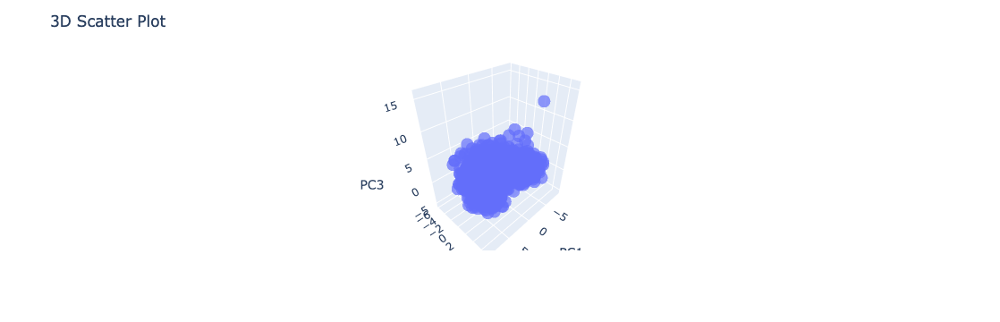

In [368]:
import plotly.express as px
df_pca = pd.DataFrame({'PC1': X_pca[:, 0], 'PC2': X_pca[:, 1], 'PC3': X_pca[:, 2]})

# Create an interactive 3D scatter plot
fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', opacity=0.7, size_max=8)

# Customize the layout
fig.update_layout(
    title="3D Scatter Plot",
    scene=dict(
        xaxis=dict(title='PC1'),
        yaxis=dict(title='PC2'),
        zaxis=dict(title='PC3')
    )
)

# Show the plot
fig.show()


#### Elbow methods and KMeans for Clustering ####

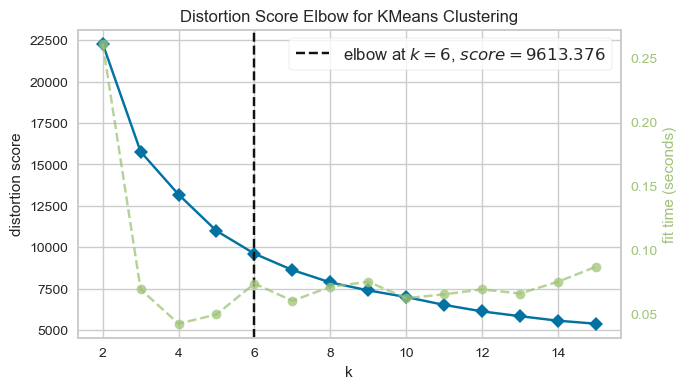

In [373]:
from yellowbrick.cluster import KElbowVisualizer

fig, ax = plt.subplots(figsize=(7, 4))
Elbow_M = KElbowVisualizer(KMeans(n_init=10), k=15, ax=ax)
Elbow_M.fit(X_pca)
Elbow_M.show()
plt.show()


In [375]:
kmeans = KMeans(n_clusters=Elbow_M.elbow_value_, n_init=10)
kmeans.fit(X_pca)
clusters = kmeans.predict(X_pca)
clusters

array([3, 4, 5, ..., 4, 3, 1], dtype=int32)

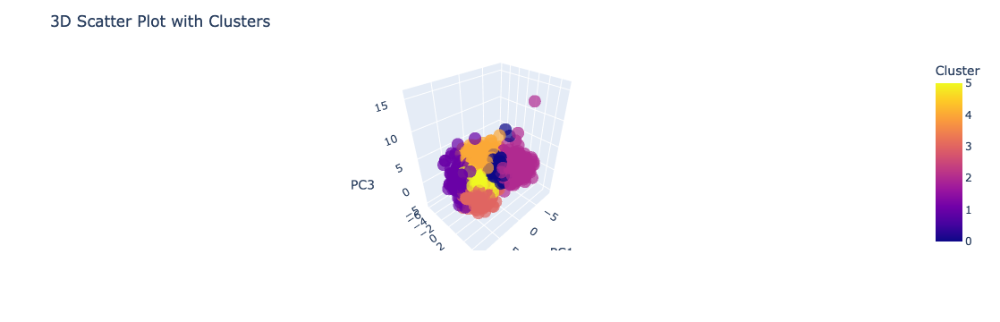

In [376]:
df_pca = pd.DataFrame({'PC1': X_pca[:, 0], 'PC2': X_pca[:, 1], 'PC3': X_pca[:, 2], 'Cluster': clusters})

# Create an interactive 3D scatter plot
fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', color='Cluster', opacity=0.7, size_max=10)

# Customize the layout
fig.update_layout(
    title="3D Scatter Plot with Clusters",
    scene=dict(
        xaxis=dict(title='PC1'),
        yaxis=dict(title='PC2'),
        zaxis=dict(title='PC3')
    )
)

# Show the plot
fig.show()



In [377]:
df['cluster'] = clusters

In [379]:
df.head()

,Age,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Response,Complain,Income_Group,Children,total_spending,total_spending_no_golds,Spend_without_gold_proportion,Spend_gold_proportion,MntWines_proportion,MntFruits_proportion,MntMeatProducts_proportion,MntFishProducts_proportion,MntSweetProducts_proportion,MntGoldProds_proportion,Campaigns_Accepted,total_purchase,NumDealsPurchases_proportion,NumWebPurchases_proportion,NumCatalogPurchases_proportion,NumStorePurchases_proportion,discount_purchase_proportion,avg_spend_per_purchase,web_cr,cluster
0,44,Graduation,Single,84835.0,0,189,104,379,111,189,218,1,4,4,6,1,0,0,0,0,0,1,0,High,0,1190,972,0.816807,0.183193,0.194444,0.106996,0.389918,0.114198,0.194444,0.224280,1,15,0.066667,0.266667,0.266667,0.400000,0.062500,79.328045,2.000000,3
1,53,Graduation,Single,57091.0,0,464,5,64,7,0,37,1,7,3,7,5,0,0,0,0,1,1,0,Upper-Medium,0,577,540,0.935875,0.064125,0.859259,0.009259,0.118519,0.012963,0.000000,0.068519,2,18,0.055556,0.388889,0.166667,0.388889,0.052632,32.053775,1.166667,4
2,56,Graduation,Relationship,67267.0,0,134,11,59,15,2,30,1,3,2,5,2,0,0,0,0,0,0,0,Upper-Medium,1,251,221,0.880478,0.119522,0.606335,0.049774,0.266968,0.067873,0.009050,0.135747,0,11,0.090909,0.272727,0.181818,0.454545,0.083333,22.816108,1.000000,5
3,47,Graduation,Relationship,32474.0,0,10,0,1,0,0,0,1,1,0,2,7,0,0,0,0,0,0,0,Low,2,11,11,1.000000,0.000000,0.909091,0.000000,0.090909,0.000000,0.000000,0.000000,0,4,0.250000,0.250000,0.000000,0.500000,0.200000,2.749313,0.125000,0
4,25,Graduation,Single,21474.0,0,6,16,24,11,0,34,2,3,1,2,7,1,0,0,0,0,1,0,Low,1,91,57,0.626374,0.373626,0.105263,0.280702,0.421053,0.192982,0.000000,0.596491,2,8,0.250000,0.375000,0.125000,0.250000,0.222222,11.373578,0.375000,2


In [380]:
# the size of each cluster 
df.groupby('cluster').count().T.iloc[0, :]

cluster
0    549
1    180
2    405
3    365
4    355
5    384
Name: Age, dtype: int64

In [381]:
df.groupby('cluster').count().T.iloc[0, :] / df.groupby('cluster').count().T.iloc[0, :].sum()

cluster
0    0.245308
1    0.080429
2    0.180965
3    0.163092
4    0.158624
5    0.171582
Name: Age, dtype: float64

In [387]:
# Select only numeric columns
numeric_df = df.select_dtypes(include='number')

# Group by 'cluster', calculate mean, transpose, and round
cluster_mean = numeric_df.groupby('cluster').mean().T.round(2)
cluster_median = numeric_df.groupby('cluster').median().T.round(2)

In [388]:
cluster_mean

cluster,0,1,2,3,4,5
Age,44.37,43.93,37.19,44.96,48.20,47.23
Income,39025.67,79858.05,25790.06,75793.67,50580.45,63626.83
Recency,50.83,45.29,49.39,51.11,45.65,49.62
MntWines,47.77,856.04,13.60,499.35,349.74,490.22
MntFruits,3.71,57.59,8.81,74.67,8.12,33.30
MntMeatProducts,25.96,453.54,19.95,468.71,77.99,185.32
MntFishProducts,6.26,87.29,13.03,106.67,11.85,42.91
MntSweetProducts,3.65,66.32,9.29,74.67,9.19,32.29
MntGoldProds,11.25,82.87,23.26,79.87,50.81,54.30
NumDealsPurchases,2.21,1.17,1.84,1.27,4.51,2.51


In [389]:
cluster_median

cluster,0,1,2,3,4,5
Age,43.00,42.00,36.00,45.00,48.00,46.50
Income,38576.00,81001.50,25252.00,75484.00,51141.00,63548.50
Recency,50.00,40.00,49.00,54.00,46.00,50.50
MntWines,30.00,909.00,7.00,450.00,284.00,452.00
MntFruits,1.00,38.00,4.00,66.00,4.00,24.00
MntMeatProducts,16.00,438.00,11.00,424.00,62.00,159.50
MntFishProducts,2.00,65.00,7.00,99.00,6.00,33.00
MntSweetProducts,1.00,50.00,5.00,65.00,3.00,24.00
MntGoldProds,6.00,60.00,15.00,59.00,34.00,38.00
NumDealsPurchases,2.00,1.00,1.00,1.00,4.00,2.00


## **Findings** ##

Based on the average values of each cluster for customer features, and considering the characteristics of each cluster, we can provide the following conclusions and names for each cluster:

1. **Cluster 0 - Middle-aged Moderate Spenders**
        Age: Around 44 years old, indicating a middle-aged group.
        Income: Lower income group with an average income of $39,025.67.
        Purchase Behavior: Moderate spending across different categories, with average spending on wines, meat products, and store purchases.
        Response Rate: Low response rate to campaigns and promotions.

2. **Cluster 1 - Affluent Wine Enthusiasts**
        Age: Around 43 years old, relatively younger.
        Income: Highest income group with an average income of $79,858.05.
        Purchase Behavior: High spending on wines (average of $856.04), overall high total spending, and higher proportion of spending on premium items like gold products.
        Response Rate: High response rate to campaigns, indicating engagement with marketing efforts.

3. **Cluster 2 - Young Frugal Shoppers**
        Age: Younger group, around 37 years old.
        Income: Lowest income group with an average income of $25,790.06.
        Purchase Behavior: Low spending across categories, particularly on luxury items like wines and gold products.
        Response Rate: Low response rate and lower engagement with marketing campaigns.

4. **Cluster 3 - Upper Middle-aged Heavy Spenders**
        Age: Around 45 years old.
        Income: High income group with an average income of $75,793.67.
        Purchase Behavior: High spending on meat products and a high proportion of store purchases.
        Response Rate: Moderate response rate to campaigns.

5. **Cluster 4 - Elderly Conservative Shoppers**
        Age: Older group, around 48 years old.
        Income: Moderate income group with an average income of $50,580.45.
        Purchase Behavior: Conservative spending patterns, moderate to low spending on various categories.
        Response Rate: Moderate response rate and engagement with campaigns.

6. **Cluster 5 - Middle-aged Balanced Spenders**
        Age: Around 47 years old, similar to Cluster 4.
        Income: Moderate to high income group with an average income of $63,626.83.
        Purchase Behavior: Balanced spending across different categories, with a moderate total spending amount.
        Response Rate: Moderate response rate to campaigns.

1. Cluster 0 - Middle-aged Moderate Spenders
        Age: Median age of 43 years, indicating a middle-aged group.
        Income: Median income of $38,576, placing them in a lower income group.
        Purchase Behavior: Moderate spending across different categories, with average spending on wines, meat products, and store purchases.
        Response Rate: Low response rate to campaigns and promotions.

2. Cluster 1 - Affluent Wine Enthusiasts
        Age: Median age of 42 years, relatively younger.
        Income: Highest median income of $81,001.50, categorizing them as the highest income group.
        Purchase Behavior: High spending on wines (median of $909), overall high total spending, and a higher proportion of spending on premium items like gold products.
        Response Rate: High response rate to campaigns, indicating engagement with marketing efforts.

3. Cluster 2 - Young Frugal Shoppers
        Age: Younger group, with a median age of 36 years.
        Income: Lowest median income of $25,252, placing them in the lowest income group.
        Purchase Behavior: Low spending across categories, particularly on luxury items like wines and gold products.
        Response Rate: Low response rate and lower engagement with marketing campaigns.

4. Cluster 3 - Upper Middle-aged Heavy Spenders
        Age: Median age of 45 years.
        Income: High median income of $75,484, categorizing them as a high-income group.
        Purchase Behavior: High spending on meat products and a high proportion of store purchases.
        Response Rate: Moderate response rate to campaigns.

5. Cluster 4 - Elderly Conservative Shoppers
        Age: Older group, with a median age of 48 years.
        Income: Moderate median income of $51,141, categorizing them as a moderate income group.
        Purchase Behavior: Conservative spending patterns, with moderate to low spending on various categories.
        Response Rate: Moderate response rate and engagement with campaigns.

6. Cluster 5 - Middle-aged Balanced Spenders
        Age: Median age of 46.50 years, similar to Cluster 4.
        Income: Moderate to high median income of $63,548.50, placing them in a moderate to high-income group.
        Purchase Behavior: Balanced spending across different categories, with a moderate total spending amount.
        Response Rate: Moderate response rate to campaigns.

1. **Cluster Analysis Based on Average Values:**

    Cluster 0 - Middle-aged Moderate Spenders: This group comprises middle-aged individuals with moderate spending habits across various categories. They have a relatively lower income level and show a low response rate to marketing campaigns.

    Cluster 1 - Affluent Wine Enthusiasts: These customers are characterized by their high income level and significant spending on wine and premium products. They are generally younger and show a high response rate to marketing campaigns.

    Cluster 2 - Young Frugal Shoppers: This group consists of younger individuals with lower income levels and minimal spending on luxury items. They exhibit a low response rate to marketing efforts.

    Cluster 3 - Upper Middle-aged Heavy Spenders: These customers are in the upper-middle-income range and tend to spend heavily on meat products and in-store purchases. They show a moderate response rate to marketing campaigns.

    Cluster 4 - Elderly Conservative Shoppers: This cluster represents older customers with moderate income levels and conservative spending patterns across different categories. They have a moderate response rate to marketing efforts.

    Cluster 5 - Middle-aged Balanced Spenders: This group exhibits a balanced spending behavior across categories, with moderate to high income levels. They show a moderate response rate to marketing campaigns.

2. Cluster Analysis Based on Median Values:

    The median-based analysis reaffirms the characteristics observed in the average-based analysis, providing additional insights into customer behavior within each cluster.

3. Recommendations and Marketing Strategies:

    Targeted Marketing: For Cluster 1 (Affluent Wine Enthusiasts), focus on premium wine offerings and personalized marketing strategies to maintain their high engagement levels.

    Engagement Strategies: Develop targeted campaigns for Cluster 3 (Upper Middle-aged Heavy Spenders) to promote meat products and in-store experiences, leveraging their heavy spending behavior.

    Segment-specific Promotions: Tailor promotions for Cluster 2 (Young Frugal Shoppers) to attract them towards higher-value purchases while considering their budget-conscious approach.

    Customer Retention: Implement strategies to retain customers in Cluster 4 (Elderly Conservative Shoppers) by offering value-driven promotions and products aligned with their conservative spending habits.

    Segmented Offerings: Develop diverse product offerings and promotions that appeal to the balanced spending behavior of customers in Cluster 0 (Middle-aged Moderate Spenders) and Cluster 5 (Middle-aged Balanced Spenders).

4. Continuous Analysis: Regularly update customer segmentation models based on changing trends and customer preferences to ensure effective targeting and marketing strategies.